StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 3, Finished, Available, Finished)

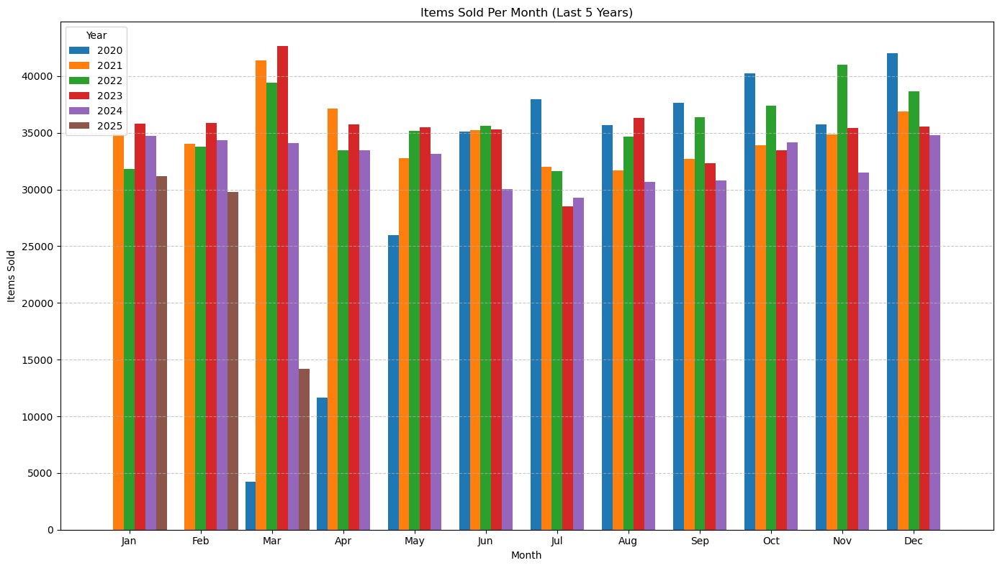

In [1]:
# Welcome to your new notebook
# Type here in the cell editor to add code!
# YOY Month-distribution

import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime, timedelta

# Step 1: Query data from Spark
df_Product = spark.sql("""
SELECT Ordered_Date, Item_Number
FROM KPMG_Bronze.dbo.CONMED_SALES_UPDATED
""")

# Convert PySpark DataFrame to Pandas DataFrame
df_pandas = df_Product.toPandas()

# Convert Ordered_Date to datetime in Pandas DataFrame
df_pandas['Ordered_Date'] = pd.to_datetime(df_pandas['Ordered_Date'])

# Filter data for the last 5 years
current_date = datetime.now()
five_years_ago = current_date - timedelta(days=5 * 365)
df_pandas = df_pandas[df_pandas['Ordered_Date'] >= five_years_ago]

# Extract Year and Month from Ordered_Date
df_pandas['Year'] = df_pandas['Ordered_Date'].dt.year
df_pandas['Month'] = df_pandas['Ordered_Date'].dt.month

# Group by Year and Month and count the number of items sold
monthly_sales = (
    df_pandas.groupby(['Year', 'Month'])
    .size()  # Count the number of occurrences
    .reset_index(name='Item_Count')  # Assign the count to 'Item_Count'
)

# Pivot the data to have months as the x-axis and years as the columns
pivot_data = monthly_sales.pivot(index='Month', columns='Year', values='Item_Count').fillna(0)

# Sort months for proper alignment
pivot_data = pivot_data.sort_index()

# Plot the bar chart
plt.figure(figsize=(14, 8))

# Create a bar for each year
for i, year in enumerate(pivot_data.columns):
    plt.bar(
        pivot_data.index + i * 0.15,  # Adjust bar positions for each year
        pivot_data[year],
        width=0.15,
        label=str(year)
    )

# Customize the plot
plt.xticks(pivot_data.index + 0.3,  # Center labels under grouped bars
           ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.xlabel('Month')
plt.ylabel('Items Sold')
plt.title('Items Sold Per Month (Last 5 Years)')
plt.legend(title='Year')
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Show the plot
plt.tight_layout()
plt.show()


In [2]:
# Check if March data is missing for that year
df_pandas[df_pandas['Month'] == 3].groupby('Year')['Item_Number'].count()


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 4, Finished, Available, Finished)

Year
2020     4256
2021    41359
2022    39424
2023    42657
2024    34104
2025    14203
Name: Item_Number, dtype: int64

In [3]:
df_pandas[(df_pandas['Year'] == 2025) & (df_pandas['Month'] == 3)].isnull().sum()


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 5, Finished, Available, Finished)

Ordered_Date    0
Item_Number     0
Year            0
Month           0
dtype: int64

In [4]:
#Check if there are fewer unique transaction dates:
df_pandas[(df_pandas['Year'] == 2025) & (df_pandas['Month'] == 3)]['Ordered_Date'].nunique()


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 6, Finished, Available, Finished)

17

In [5]:
#Ensure that data was correctly imported from Spark SQL by running:
df_pandas[df_pandas['Year'] == 2025]['Ordered_Date'].min(), df_pandas[df_pandas['Year'] == 2025]['Ordered_Date'].max()


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 7, Finished, Available, Finished)

(Timestamp('2025-01-01 00:00:00'), Timestamp('2025-03-17 00:00:00'))

In [6]:


# Count sales per day in March 2025
march_2025_sales = df_pandas[(df_pandas['Year'] == 2025) & (df_pandas['Month'] == 3)]
daily_counts = march_2025_sales.groupby('Ordered_Date').size()

# Check for missing days
all_days_march = pd.date_range(start="2025-03-01", end="2025-03-31")
missing_days = set(all_days_march) - set(daily_counts.index)

print("Missing Days in March 2025:", missing_days)


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 8, Finished, Available, Finished)

Missing Days in March 2025: {Timestamp('2025-03-28 00:00:00'), Timestamp('2025-03-24 00:00:00'), Timestamp('2025-03-27 00:00:00'), Timestamp('2025-03-23 00:00:00'), Timestamp('2025-03-25 00:00:00'), Timestamp('2025-03-30 00:00:00'), Timestamp('2025-03-20 00:00:00'), Timestamp('2025-03-18 00:00:00'), Timestamp('2025-03-26 00:00:00'), Timestamp('2025-03-21 00:00:00'), Timestamp('2025-03-19 00:00:00'), Timestamp('2025-03-29 00:00:00'), Timestamp('2025-03-31 00:00:00'), Timestamp('2025-03-22 00:00:00')}


In [7]:
# Group by year and get total sales for March in each year
march_sales_trends = df_pandas[df_pandas['Month'] == 3].groupby('Year').size()
print(march_sales_trends)


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 9, Finished, Available, Finished)

Year
2020     4256
2021    41359
2022    39424
2023    42657
2024    34104
2025    14203
dtype: int64


In [8]:
# Count sales per item in March for each year
march_item_sales = df_pandas[df_pandas['Month'] == 3].groupby(['Year', 'Item_Number']).size().unstack(fill_value=0)

# Check which items had a significant drop in 2025
march_item_sales['Drop_2025'] = march_item_sales[2024] - march_item_sales[2025]
print(march_item_sales.sort_values(by='Drop_2025', ascending=False).head(10))


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 10, Finished, Available, Finished)

KeyError: 2024

In [ ]:
SELECT COUNT(*) FROM KPMG_Bronze.dbo.CONMED_SALES_UPDATED
WHERE YEAR(Ordered_Date) = 2025 AND MONTH(Ordered_Date) = 3;


In [ ]:
df = spark.sql("""SELECT COUNT(*) FROM KPMG_Bronze.dbo.CONMED_SALES_UPDATED
WHERE YEAR(Ordered_Date) = 2025 AND MONTH(Ordered_Date) = 3""")
display(df)


In [11]:
# Print some sample March 2025 data
print(df_pandas[(df_pandas['Year'] == 2025) & (df_pandas['Month'] == 3)].head(10))


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 13, Finished, Available, Finished)

     Ordered_Date Item_Number  Year  Month
136    2025-03-07      430336  2025      3
151    2025-03-07      430336  2025      3
152    2025-03-07      430336  2025      3
164    2025-03-07      430336  2025      3
489    2025-03-05      430336  2025      3
569    2025-03-14      430336  2025      3
1663   2025-03-05      430336  2025      3
2154   2025-03-14      430336  2025      3
2237   2025-03-12      430336  2025      3
2280   2025-03-03      430336  2025      3


In [12]:
# Filter data for Q1 (January, February, March)
q1_sales = df_pandas[df_pandas['Month'].isin([1, 2, 3])]

# Group by Year and count items sold in Q1
q1_counts = q1_sales.groupby('Year').size()

# Print the Q1 sales count for each year
print(q1_counts)


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 14, Finished, Available, Finished)

Year
2020      4256
2021    110242
2022    104968
2023    114359
2024    103213
2025     75147
dtype: int64


In [13]:
import pandas as pd
import matplotlib.pyplot as plt

# Filter data for Q1 (January, February, March)
q1_sales = df_pandas[df_pandas['Month'].isin([1, 2, 3])]

# Group by Year and Month to count items sold
q1_monthly_sales = q1_sales.groupby(['Year', 'Month']).size().reset_index(name='Item_Count')

# Pivot for visualization
q1_pivot = q1_monthly_sales.pivot(index='Month', columns='Year', values='Item_Count').fillna(0)

# Sort index to ensure Jan → Mar order
q1_pivot = q1_pivot.sort_index()


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 15, Finished, Available, Finished)

StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 16, Finished, Available, Finished)

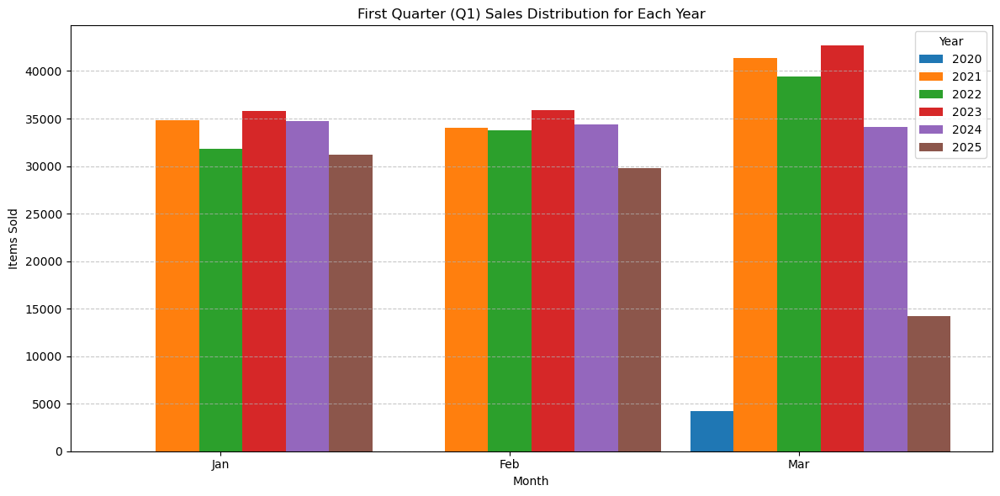

In [14]:
# Set up figure size
plt.figure(figsize=(12, 6))

# Define width for bars
bar_width = 0.15

# Create bars for each year
for i, year in enumerate(q1_pivot.columns):
    plt.bar(
        q1_pivot.index + i * bar_width,  # Offset bars for each year
        q1_pivot[year],
        width=bar_width,
        label=str(year)
    )

# Customize the plot
plt.xticks(q1_pivot.index + 0.3, ['Jan', 'Feb', 'Mar'])
plt.xlabel('Month')
plt.ylabel('Items Sold')
plt.title('First Quarter (Q1) Sales Distribution for Each Year')
plt.legend(title='Year')
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Show plot
plt.tight_layout()
plt.show()


In [15]:
# Filter data for March across all years
march_data = df_pandas[df_pandas['Month'] == 3]

# Group by Year and Ordered_Date to count items sold each day
march_daily_sales = march_data.groupby(['Year', 'Ordered_Date']).size().reset_index(name='Item_Count')

# Print the first few rows to inspect
print(march_daily_sales.head())


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 17, Finished, Available, Finished)

   Year Ordered_Date  Item_Count
0  2020   2020-03-27        1441
1  2020   2020-03-28          14
2  2020   2020-03-29          12
3  2020   2020-03-30        1754
4  2020   2020-03-31        1035


In [16]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.dates as mdates

# Filter data for March across all years
march_data = df_pandas[df_pandas['Month'] == 3]

# Group by Year and Ordered_Date to count items sold per day
march_daily_sales = march_data.groupby(['Year', 'Ordered_Date']).size().reset_index(name='Item_Count')

# Print first few rows to inspect
print(march_daily_sales.head())


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 18, Finished, Available, Finished)

   Year Ordered_Date  Item_Count
0  2020   2020-03-27        1441
1  2020   2020-03-28          14
2  2020   2020-03-29          12
3  2020   2020-03-30        1754
4  2020   2020-03-31        1035


In [17]:
# Get unique March dates for each year
march_dates = df_pandas[df_pandas['Month'] == 3]['Ordered_Date'].unique()
print(sorted(march_dates))


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 19, Finished, Available, Finished)

[Timestamp('2020-03-27 00:00:00'), Timestamp('2020-03-28 00:00:00'), Timestamp('2020-03-29 00:00:00'), Timestamp('2020-03-30 00:00:00'), Timestamp('2020-03-31 00:00:00'), Timestamp('2021-03-01 00:00:00'), Timestamp('2021-03-02 00:00:00'), Timestamp('2021-03-03 00:00:00'), Timestamp('2021-03-04 00:00:00'), Timestamp('2021-03-05 00:00:00'), Timestamp('2021-03-06 00:00:00'), Timestamp('2021-03-07 00:00:00'), Timestamp('2021-03-08 00:00:00'), Timestamp('2021-03-09 00:00:00'), Timestamp('2021-03-10 00:00:00'), Timestamp('2021-03-11 00:00:00'), Timestamp('2021-03-12 00:00:00'), Timestamp('2021-03-13 00:00:00'), Timestamp('2021-03-14 00:00:00'), Timestamp('2021-03-15 00:00:00'), Timestamp('2021-03-16 00:00:00'), Timestamp('2021-03-17 00:00:00'), Timestamp('2021-03-18 00:00:00'), Timestamp('2021-03-19 00:00:00'), Timestamp('2021-03-20 00:00:00'), Timestamp('2021-03-21 00:00:00'), Timestamp('2021-03-22 00:00:00'), Timestamp('2021-03-23 00:00:00'), Timestamp('2021-03-24 00:00:00'), Timestamp('20

In [19]:
# Extract only March 2025 data
march_2025 = df_pandas[(df_pandas['Year'] == 2025) & (df_pandas['Month'] == 3)]

# Get unique days in March 2025
unique_days_2025 = sorted(march_2025['Ordered_Date'].dt.day.unique())
print("Days available in March 2025:", unique_days_2025)


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 21, Finished, Available, Finished)

Days available in March 2025: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17]


In [20]:
# Create a full date range for March 2025
full_march_2025 = pd.DataFrame({'Ordered_Date': pd.date_range('2025-03-01', '2025-03-31')})

# Merge with existing data, filling missing values with 0
march_2025_filled = full_march_2025.merge(march_2025, on='Ordered_Date', how='left').fillna(0)

# Print the fixed data
print(march_2025_filled)


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 22, Finished, Available, Finished)

      Ordered_Date  Item_Number    Year  Month
0       2025-03-01  00505927900  2025.0    3.0
1       2025-03-01  00505927900  2025.0    3.0
2       2025-03-01  00505927900  2025.0    3.0
3       2025-03-01  00505903101  2025.0    3.0
4       2025-03-01  00505927800  2025.0    3.0
...            ...          ...     ...    ...
14212   2025-03-27            0     0.0    0.0
14213   2025-03-28            0     0.0    0.0
14214   2025-03-29            0     0.0    0.0
14215   2025-03-30            0     0.0    0.0
14216   2025-03-31            0     0.0    0.0

[14217 rows x 4 columns]


In [21]:
plt.figure(figsize=(14, 6))
sns.lineplot(data=march_2025_filled, x='Ordered_Date', y='Item_Count', marker='o')

plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%d-%b'))
plt.gca().xaxis.set_major_locator(mdates.DayLocator(interval=3))
plt.xticks(rotation=45)

plt.xlabel('Date in March 2025')
plt.ylabel('Items Sold')
plt.title('Daily Sales Trend in March 2025')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 23, Finished, Available, Finished)

ValueError: Could not interpret value `Item_Count` for parameter `y`

In [ ]:
# Filter data for Q1 (Jan, Feb, Mar)
q1_data = df_pandas[df_pandas['Month'].isin([1, 2, 3])]


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 25, Finished, Available, Finished)

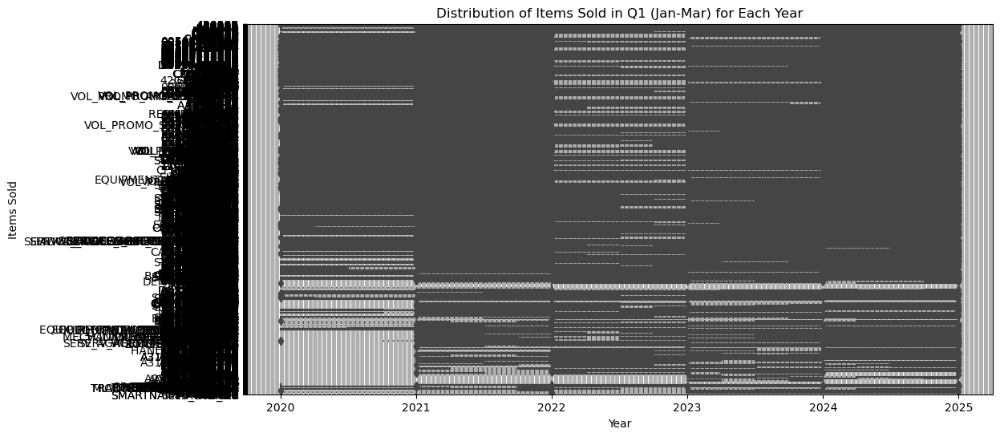

In [23]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
sns.boxplot(data=q1_data, x="Year", y="Item_Number")

plt.xlabel("Year")
plt.ylabel("Items Sold")
plt.title("Distribution of Items Sold in Q1 (Jan-Mar) for Each Year")
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.show()


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 26, Finished, Available, Finished)

/home/trusted-service-user/cluster-env/trident_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/trusted-service-user/cluster-env/trident_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/trusted-service-user/cluster-env/trident_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/trusted-service-user/cluster-env/trident_env/lib/python3.11/site-packages/seaborn/_ol

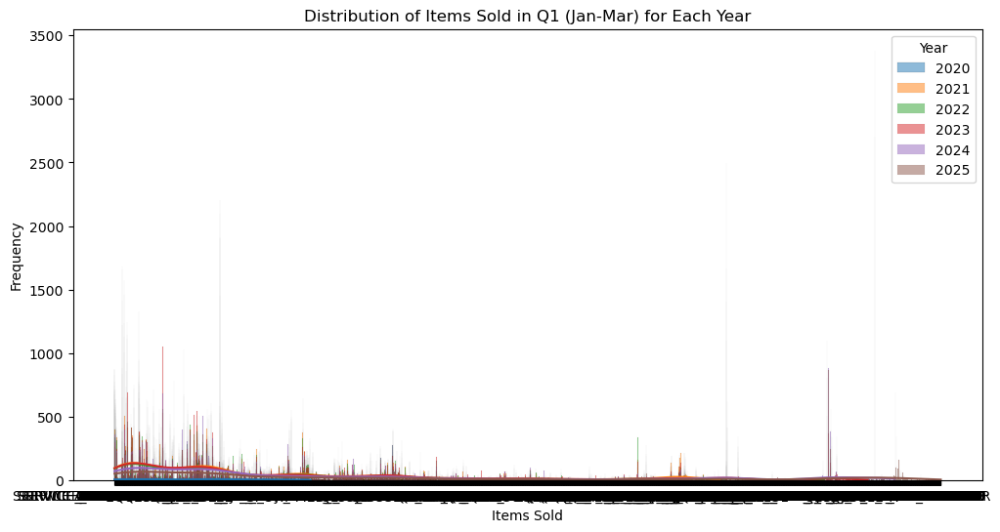

In [24]:
plt.figure(figsize=(12, 6))

# Plot a histogram for each year
for year in sorted(q1_data["Year"].unique()):
    subset = q1_data[q1_data["Year"] == year]
    sns.histplot(subset["Item_Number"], bins=30, kde=True, label=str(year), alpha=0.5)

plt.xlabel("Items Sold")
plt.ylabel("Frequency")
plt.title("Distribution of Items Sold in Q1 (Jan-Mar) for Each Year")
plt.legend(title="Year")
plt.show()


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 27, Finished, Available, Finished)

/home/trusted-service-user/cluster-env/trident_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/trusted-service-user/cluster-env/trident_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


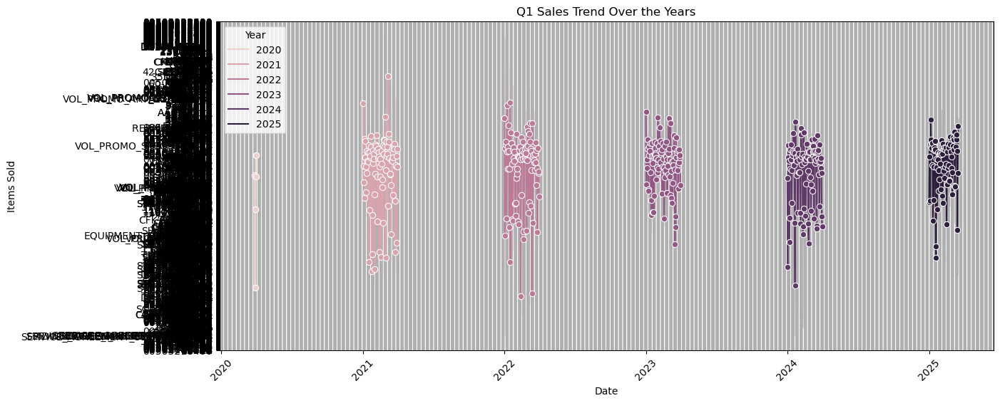

In [25]:
plt.figure(figsize=(14, 6))
sns.lineplot(data=q1_data, x="Ordered_Date", y="Item_Number", hue="Year", marker="o")

plt.xlabel("Date")
plt.ylabel("Items Sold")
plt.title("Q1 Sales Trend Over the Years")
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.legend(title="Year")
plt.xticks(rotation=45)
plt.show()


In [26]:
# Filter data for Q1 (January - March)
q1_data = df_pandas[df_pandas['Month'].isin([1, 2, 3])]


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 28, Finished, Available, Finished)

In [27]:
# Get top 5 most sold items for each year in Q1
common_items_q1 = (
    q1_data.groupby(['Year', 'Item_Number'])
    .size()
    .reset_index(name='Item_Count')
    .sort_values(['Year', 'Item_Count'], ascending=[True, False])
)

# Get the top 5 most sold items for each year
top_items_per_year = common_items_q1.groupby('Year').head(5)

print(top_items_per_year)


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 29, Finished, Available, Finished)

       Year                  Item_Number  Item_Count
816    2020  SERVICE AGREEMENT - IMAGING         111
596    2020                     CKP-4500          69
817    2020    SERVICE AGREEMENT - POWER          51
259    2020                     239025M5          44
384    2020                     AES-90SN          43
3325   2021                REPAIR CHARGE        2207
2016   2021                     AES-90SN        1574
1399   2021                       10K100        1331
3368   2021    SERVICE AGREEMENT - POWER        1219
942    2021                  00502313800        1140
6250   2022                REPAIR CHARGE        1907
6299   2022    SERVICE AGREEMENT - POWER        1679
4852   2022                     AES-90SN        1237
3715   2022                  00502313800        1113
5862   2022                         K475        1095
9056   2023                REPAIR CHARGE        1912
8679   2023                         K475        1666
9101   2023    SERVICE AGREEMENT - POWER      

In [28]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(14, 6))
sns.barplot(data=top_items_per_year, x="Item_Number", y="Item_Count", hue="Year")

plt.xlabel("Item Number")
plt.ylabel("Items Sold")
plt.title("Top 5 Most Sold Items in Q1 for Each Year")
plt.xticks(rotation=45)
plt.legend(title="Year")
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.show()


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 30, Finished, Available, Finished)

AttributeError: 'numpy.int32' object has no attribute 'startswith'

In [ ]:
# Count the number of years each item appears in
common_across_years = common_items_q1.groupby("Item_Number")["Year"].nunique()

# Filter items that were present in all years
items_sold_all_years = common_across_years[common_across_years == q1_data["Year"].nunique()]
print(items_sold_all_years)


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, -1, Cancelled, , Cancelled)

In [ ]:
# Get top items for 2025
top_2025 = top_items_per_year[top_items_per_year["Year"] == 2025]["Item_Number"]

# Get top items for previous years
top_other_years = top_items_per_year[top_items_per_year["Year"] != 2025]["Item_Number"].unique()

# Find items missing in 2025
missing_items = set(top_other_years) - set(top_2025)
print("Items that were popular before but missing in 2025:", missing_items)


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, -1, Cancelled, , Cancelled)

In [ ]:
# Group data by Year and Month (only Q1)
q1_sales_trend = (
    df_pandas[df_pandas["Month"].isin([1, 2, 3])]
    .groupby(["Year", "Month"])
    .size()
    .reset_index(name="Item_Count")
)

# Visualize the trend
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
sns.lineplot(data=q1_sales_trend, x="Month", y="Item_Count", hue="Year", marker="o")

plt.xticks([1, 2, 3], ["Jan", "Feb", "Mar"])
plt.xlabel("Month")
plt.ylabel("Items Sold")
plt.title("Q1 Monthly Sales Trend for Each Year")
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.legend(title="Year")
plt.show()


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, -1, Cancelled, , Cancelled)

In [ ]:
# Filter only March data
march_sales = df_pandas[df_pandas["Month"] == 3].groupby(["Year"]).size().reset_index(name="Item_Count")

# Visualize March-only trend
plt.figure(figsize=(10, 5))
sns.barplot(data=march_sales, x="Year", y="Item_Count", palette="viridis")

plt.xlabel("Year")
plt.ylabel("Items Sold in March")
plt.title("March Sales Across Years")
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.show()


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, -1, Cancelled, , Cancelled)

In [ ]:
#Find which items had the biggest sales drop in March 2025.
# Group data by Year and Item_Number for March only
march_items = df_pandas[df_pandas["Month"] == 3].groupby(["Year", "Item_Number"]).size().reset_index(name="Item_Count")

# Pivot to compare March sales across years
march_items_pivot = march_items.pivot(index="Item_Number", columns="Year", values="Item_Count").fillna(0)

# Find items that declined in 2025
march_items_pivot["Change_2025"] = march_items_pivot[2025] - march_items_pivot[2024]
march_items_pivot_sorted = march_items_pivot.sort_values("Change_2025")

# Show top items with biggest decline
print(march_items_pivot_sorted.head(10))


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, -1, Cancelled, , Cancelled)

In [ ]:
#Items that were sold before but disappeared in 2025
# Get unique items sold in March for each year
items_2025 = set(march_items[march_items["Year"] == 2025]["Item_Number"])
items_2024 = set(march_items[march_items["Year"] == 2024]["Item_Number"])
items_2023 = set(march_items[march_items["Year"] == 2023]["Item_Number"])

# Find items missing in 2025 but present before
missing_items = items_2024.union(items_2023) - items_2025
print("Items that were sold in previous years but missing in 2025:", missing_items)


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, -1, Cancelled, , Cancelled)

In [ ]:
# Filter for March 2025 only
march_2025_sales = df_pandas[(df_pandas["Year"] == 2025) & (df_pandas["Month"] == 3)]

# Group by date
daily_sales_march_2025 = march_2025_sales.groupby("Ordered_Date").size().reset_index(name="Item_Count")

# Plot daily sales trend
plt.figure(figsize=(12, 6))
sns.lineplot(data=daily_sales_march_2025, x="Ordered_Date", y="Item_Count", marker="o")

plt.xlabel("Date")
plt.ylabel("Items Sold")
plt.title("Daily Sales Trend in March 2025")
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.xticks(rotation=45)
plt.show()


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, -1, Cancelled, , Cancelled)

In [ ]:
# Filter for March 2025 only
march_2025_sales = df_pandas[(df_pandas["Year"] == 2024) & (df_pandas["Month"] == 3)]

# Group by date
daily_sales_march_2025 = march_2025_sales.groupby("Ordered_Date").size().reset_index(name="Item_Count")

# Plot daily sales trend
plt.figure(figsize=(12, 6))
sns.lineplot(data=daily_sales_march_2025, x="Ordered_Date", y="Item_Count", marker="o")

plt.xlabel("Date")
plt.ylabel("Items Sold")
plt.title("Daily Sales Trend in March 2025")
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.xticks(rotation=45)
plt.show()


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, -1, Cancelled, , Cancelled)

In [ ]:
# Filter for March 2025 only
march_2025_sales = df_pandas[(df_pandas["Year"] == 2023) & (df_pandas["Month"] == 3)]

# Group by date
daily_sales_march_2025 = march_2025_sales.groupby("Ordered_Date").size().reset_index(name="Item_Count")

# Plot daily sales trend
plt.figure(figsize=(12, 6))
sns.lineplot(data=daily_sales_march_2025, x="Ordered_Date", y="Item_Count", marker="o")

plt.xlabel("Date")
plt.ylabel("Items Sold")
plt.title("Daily Sales Trend in March 2025")
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.xticks(rotation=45)
plt.show()


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, -1, Cancelled, , Cancelled)

In [ ]:
# Filter for March 2025 only
march_2025_sales = df_pandas[(df_pandas["Year"] == 2022) & (df_pandas["Month"] == 3)]

# Group by date
daily_sales_march_2025 = march_2025_sales.groupby("Ordered_Date").size().reset_index(name="Item_Count")

# Plot daily sales trend
plt.figure(figsize=(12, 6))
sns.lineplot(data=daily_sales_march_2025, x="Ordered_Date", y="Item_Count", marker="o")

plt.xlabel("Date")
plt.ylabel("Items Sold")
plt.title("Daily Sales Trend in March 2025")
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.xticks(rotation=45)
plt.show()


In [ ]:
# Filter for March 2025 only
march_2025_sales = df_pandas[(df_pandas["Year"] == 2021) & (df_pandas["Month"] == 3)]

# Group by date
daily_sales_march_2025 = march_2025_sales.groupby("Ordered_Date").size().reset_index(name="Item_Count")

# Plot daily sales trend
plt.figure(figsize=(12, 6))
sns.lineplot(data=daily_sales_march_2025, x="Ordered_Date", y="Item_Count", marker="o")

plt.xlabel("Date")
plt.ylabel("Items Sold")
plt.title("Daily Sales Trend in March 2025")
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.xticks(rotation=45)
plt.show()


In [ ]:
# Filter for March 2025 only
march_2025_sales = df_pandas[(df_pandas["Year"] == 2020) & (df_pandas["Month"] == 3)]

# Group by date
daily_sales_march_2025 = march_2025_sales.groupby("Ordered_Date").size().reset_index(name="Item_Count")

# Plot daily sales trend
plt.figure(figsize=(12, 6))
sns.lineplot(data=daily_sales_march_2025, x="Ordered_Date", y="Item_Count", marker="o")

plt.xlabel("Date")
plt.ylabel("Items Sold")
plt.title("Daily Sales Trend in March 2025")
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.xticks(rotation=45)
plt.show()


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Ensure Ordered_Date is in datetime format
df_pandas["Ordered_Date"] = pd.to_datetime(df_pandas["Ordered_Date"])

# Filter for March (2020-2025)
df_march = df_pandas[(df_pandas["Month"] == 3) & (df_pandas["Year"].between(2020, 2025))].copy()

# Extract only the day of March (1-31) to align x-axis
df_march["Day"] = df_march["Ordered_Date"].dt.day

# Group by Day and Year to count items sold
daily_sales = df_march.groupby(["Day", "Year"]).size().reset_index(name="Item_Count")

# Plot settings
plt.figure(figsize=(14, 6))
palette = sns.color_palette("tab10", n_colors=6)  # DISTINCT colors

# Loop through each year and plot
for i, year in enumerate(range(2020, 2026)):
    df_year = daily_sales[daily_sales["Year"] == year]
    sns.lineplot(data=df_year, x="Day", y="Item_Count", marker="o", label=f"March {year}", color=palette[i])

# Improve x-axis readability
plt.xticks(range(1, 32), rotation=45)
plt.xlabel("Day of March")
plt.ylabel("Items Sold")
plt.title("Daily Sales Trend in March (2020-2025)")
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.legend(title="Year", loc="upper right")
plt.tight_layout()

# Show plot
plt.show()


please upload to lakehouse

In [ ]:
# Get unique customers for each year
customers_2025 = set(df_Customers[df_Customers["Ordered_Date"] == 2025]["Customer_Class_Code"])
customers_2024 = set(df_Customers[df_Customers["Ordered_Date"] == 2024]["Customer_Class_Code"])
customers_2023 = set(df_Customers[df_Customers["Ordered_Date"] == 2023]["Customer_Class_Code"])
customers_2022 = set(df_Customers[df_Customers["Ordered_Date"] == 2022]["Customer_Class_Code"])
customers_2021 = set(df_Customers[df_Customers["Ordered_Date"] == 2021]["Customer_Class_Code"])
customers_2020 = set(df_Customers[df_Customers["Ordered_Date"] == 2020]["Customer_Class_Code"])


In [34]:
# Step 1: Query data from Spark
df_Customers = spark.sql("""
SELECT Ordered_Date, Item_Number,Customer_Class_Code,Quantity_Ordered,Product_Segment_Extnl_Cap_Disp
FROM KPMG_Bronze.dbo.CONMED_SALES_UPDATED
""")

StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 36, Finished, Available, Finished)

In [35]:
import pandas as pd

# Convert to Pandas DataFrame
df_pandas = df_Customers.toPandas()

# Convert Ordered_Date to datetime format
df_pandas["Ordered_Date"] = pd.to_datetime(df_pandas["Ordered_Date"])

# Extract Year and Month
df_pandas["Year"] = df_pandas["Ordered_Date"].dt.year
df_pandas["Month"] = df_pandas["Ordered_Date"].dt.month

# Filter only Q1 data (January-March)
df_q1 = df_pandas[df_pandas["Month"].isin([1, 2, 3])]

# Get unique customers per year
customers_per_year = {
    year: set(df_q1[df_q1["Year"] == year]["Customer_Class_Code"])
    for year in df_q1["Year"].unique()
}

# Print unique customers per year (sample)
for year, customers in customers_per_year.items():
    print(f"Year {year}: {len(customers)} customers")


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 37, Finished, Available, Finished)

Year 2023: 22 customers
Year 2020: 22 customers
Year 2021: 24 customers
Year 2022: 21 customers
Year 2025: 23 customers
Year 2024: 24 customers
Year 2017: 6 customers
Year 2018: 7 customers
Year 2019: 8 customers
Year 2014: 4 customers
Year 2015: 3 customers
Year 2016: 6 customers
Year 2013: 3 customers
Year 2012: 2 customers
Year 2010: 1 customers
Year 2011: 1 customers


In [36]:
# Get all previous years' customers
previous_customers = set()
for year in customers_per_year.keys():
    if year != 2025:
        previous_customers.update(customers_per_year[year])

# Customers who stopped buying in 2025
lost_customers = previous_customers - customers_per_year.get(2025, set())

print(f"Total customers lost in 2025 (compared to earlier years): {len(lost_customers)}")
print("Sample lost customers:", list(lost_customers)[:10])  # Show first 10


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 38, Finished, Available, Finished)

Total customers lost in 2025 (compared to earlier years): 4
Sample lost customers: ['OEM', 'FOOT ANKLE DIST', 'FIELD INVENTORY', 'ENT']


In [37]:
# Filter for lost customers
lost_customers_data = df_q1[df_q1["Customer_Class_Code"].isin(lost_customers)]

# Sum total items ordered per lost customer
customer_sales = (
    lost_customers_data.groupby("Customer_Class_Code")["Quantity_Ordered"]
    .sum()
    .reset_index()
    .sort_values(by="Quantity_Ordered", ascending=False)
)

print(customer_sales.head(10))  # Top 10 lost customers with highest previous purchases


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 39, Finished, Available, Finished)

  Customer_Class_Code Quantity_Ordered
3                 OEM        44.000000
2     FOOT ANKLE DIST        21.000000
0                 ENT        15.000000
1     FIELD INVENTORY       -58.000000


In [38]:
# Group by Item_Number and count total sales in Q1
q1_item_sales = (
    df_q1.groupby(["Year", "Item_Number"])["Quantity_Ordered"]
    .sum()
    .reset_index()
)

# Find top 5 most sold items per year
top_items_per_year = q1_item_sales.groupby("Year").apply(
    lambda x: x.nlargest(5, "Quantity_Ordered")
).reset_index(drop=True)

print(top_items_per_year)


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 40, Finished, Available, Finished)

TypeError: Column 'Quantity_Ordered' has dtype object, cannot use method 'nlargest' with this dtype

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Get lost customers per year
lost_customers_per_year = {
    year: len(customers_per_year[year] - customers_per_year.get(year + 1, set()))
    for year in sorted(customers_per_year.keys())[:-1]  # Exclude 2025
}

# Convert to DataFrame
df_lost = pd.DataFrame(list(lost_customers_per_year.items()), columns=["Year", "Lost_Customers"])

# Plot lost customers per year
plt.figure(figsize=(10, 5))
sns.barplot(data=df_lost, x="Year", y="Lost_Customers", palette="coolwarm")

plt.xlabel("Year")
plt.ylabel("Customers Lost in Next Year")
plt.title("Customer Churn Trends (Q1)")
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.show()


In [ ]:
print(4)

In [ ]:
df_news = spark.sql(""" select Account_Number,Ordered_Date, Item_Number,
Quantity_Ordered,
Product_Segment_Extnl_Cap_Disp,
Invoiced_Date,
Item_Description,
Major_Description,
Customer_Class_Code,
Resolved_Price_USD
from KPMG_Bronze.dbo.CONMED_SALES_UPDATED""")
display(df_news)

In [42]:
from pyspark.sql.functions import col, sum, count, max, datediff, lit
from pyspark.sql import functions as F

# Convert date columns to date format (if not already)
df_news = df_news.withColumn("Ordered_Date", col("Ordered_Date").cast("date"))
df_news = df_news.withColumn("Invoiced_Date", col("Invoiced_Date").cast("date"))

# Filter data for Q1 2020
df_q1_2020 = df_news.filter((col("Ordered_Date") >= "2020-01-01") & (col("Ordered_Date") <= "2020-03-31"))

# Calculate the latest transaction date in Q1 2020
max_date = df_q1_2020.agg(max("Ordered_Date")).collect()[0][0]

# RFM Calculation
rfm_df = df_q1_2020.groupBy("Account_Number").agg(
    datediff(lit(max_date), max("Ordered_Date")).alias("Recency"),  # Days since last purchase
    count("Quantity_Ordered").alias("Frequency"),  # Number of transactions
    sum("Resolved_Price_USD").alias("Monetary")  # Total spending
)

# Display the final RFM DataFrame
display(rfm_df)


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 44, Finished, Available, Finished)

SynapseWidget(Synapse.DataFrame, 9c3c76a2-248a-4ba8-8897-3c65fb09fd0a)

In [43]:
from pyspark.sql.functions import col, sum, count, max, datediff, lit
from pyspark.sql import functions as F

# Convert date columns to date format (if not already)
df_news = df_news.withColumn("Ordered_Date", col("Ordered_Date").cast("date"))
df_news = df_news.withColumn("Invoiced_Date", col("Invoiced_Date").cast("date"))

# Filter data for Q1 2020
df_q1_2020 = df_news.filter((col("Ordered_Date") >= "2020-01-01") & (col("Ordered_Date") <= "2020-03-31"))

# Calculate the latest transaction date in Q1 2020
max_date = df_q1_2020.agg(max("Ordered_Date")).collect()[0][0]

# RFM Calculation
rfm_df = df_q1_2020.groupBy("Account_Number").agg(
    datediff(lit(max_date), max("Ordered_Date")).alias("Recency"),  # Days since last purchase
    count("Quantity_Ordered").alias("Frequency"),  # Number of transactions
    sum("Resolved_Price_USD").alias("Monetary")  # Total spending
)

# Join RFM values back to the original DataFrame
df_final = df_q1_2020.join(rfm_df, on="Account_Number", how="left")

# Display the final DataFrame with all columns and RFM values
display(df_final)


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 45, Finished, Available, Finished)

SynapseWidget(Synapse.DataFrame, dca50f34-d821-4b0b-b416-b8a5513a0323)

In [44]:
from pyspark.sql.functions import ntile
from pyspark.sql.window import Window


# Rank customers into 5 bins (1 = worst, 5 = best)
df_final = df_final.withColumn("R_Score", ntile(5).over(Window.orderBy("Recency")))
df_final = df_final.withColumn("F_Score", ntile(5).over(Window.orderBy(col("Frequency").desc())))
df_final = df_final.withColumn("M_Score", ntile(5).over(Window.orderBy(col("Monetary").desc())))

# Create RFM Score as a string
df_final = df_final.withColumn("RFM_Score", col("R_Score") + col("F_Score") + col("M_Score"))

# Show results
display(df_final)

StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 46, Finished, Available, Finished)

SynapseWidget(Synapse.DataFrame, 20c81d2a-8f8d-4f98-9823-a58cfa9a8fee)

In [45]:
from pyspark.sql.functions import when

df_final = df_final.withColumn("Segment",
    when(col("RFM_Score") >= 13, "VIP Customer")
    .when((col("RFM_Score") >= 10) & (col("RFM_Score") < 13), "Loyal Customer")
    .when((col("RFM_Score") >= 6) & (col("RFM_Score") < 10), "At-Risk Customer")
    .otherwise("Lost Customer")
)

display(df_final)

StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 47, Finished, Available, Finished)

SynapseWidget(Synapse.DataFrame, faeb68f6-1684-454d-ac15-08dce5747b4f)

In [46]:
import pandas as pd
import plotly.express as px

# Convert PySpark DataFrame to Pandas
rfm_pandas = df_final.select("Segment").toPandas()

# Count the number of customers in each segment
rfm_counts = rfm_pandas["Segment"].value_counts().reset_index()
rfm_counts.columns = ["Segment", "Count"]

# Plot the chart
fig = px.bar(
    rfm_counts,
    x="Segment",
    y="Count",
    color="Segment",
    title="Customer Segmentation Distribution",
    text_auto=True
)

fig.show()


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 48, Finished, Available, Finished)

In [47]:
import plotly.express as px

# Convert PySpark DataFrame to Pandas
rfm_pandas = df_final.select("Recency", "Frequency", "Monetary", "Segment").toPandas()

# Plot scatter plot
fig = px.scatter(
    rfm_pandas,
    x="Recency",  # More recent purchases should be to the left
    y="Monetary",  # Higher spenders at the top
    size="Frequency",  # More purchases = Bigger bubble
    color="Segment",  # Color by customer segment
    title="RFM Customer Segmentation Scatter Plot",
    hover_data=["Recency", "Frequency", "Monetary"]
)

fig.show()


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 49, Finished, Available, Finished)

In [48]:
from pyspark.sql.functions import col

# Convert RFM_Score to double if needed
df_final = df_final.withColumn("RFM_Score", col("RFM_Score").cast("double"))
df_final = df_final.withColumn("Recency", col("Recency").cast("double"))
df_final = df_final.withColumn("Frequency", col("Frequency").cast("double"))
df_final = df_final.withColumn("Monetary", col("Monetary").cast("double"))

df_final.printSchema()  # Check data types


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 50, Finished, Available, Finished)

root
 |-- Account_Number: string (nullable = true)
 |-- Ordered_Date: date (nullable = true)
 |-- Item_Number: string (nullable = true)
 |-- Quantity_Ordered: decimal(34,6) (nullable = true)
 |-- Product_Segment_Extnl_Cap_Disp: string (nullable = true)
 |-- Invoiced_Date: date (nullable = true)
 |-- Item_Description: string (nullable = true)
 |-- Major_Description: string (nullable = true)
 |-- Customer_Class_Code: string (nullable = true)
 |-- Resolved_Price_USD: decimal(34,6) (nullable = true)
 |-- Recency: double (nullable = true)
 |-- Frequency: double (nullable = true)
 |-- Monetary: double (nullable = true)
 |-- R_Score: integer (nullable = false)
 |-- F_Score: integer (nullable = false)
 |-- M_Score: integer (nullable = false)
 |-- RFM_Score: double (nullable = false)
 |-- Segment: string (nullable = false)



In [49]:
from pyspark.ml.feature import VectorAssembler

    # Assemble numeric features into a single vector column
    assembler = VectorAssembler(
        inputCols=["Recency", "Frequency", "Monetary"], 
        outputCol="features",
        handleInvalid="skip"  # Drop rows with invalid data
    )

    rfm_df_transformed = assembler.transform(df_final)
    rfm_df_transformed.select("features").show(5, truncate=False)  # Check transformation
    from pyspark.ml.feature import VectorAssembler

    # Assemble numeric features into a single vector column
    assembler = VectorAssembler(
        inputCols=["Recency", "Frequency", "Monetary"], 
        outputCol="features",
        handleInvalid="skip"  # Drop rows with invalid data
    )

    rfm_df_transformed = assembler.transform(df_final)
    rfm_df_transformed.select("features").show(5, truncate=False)  # Check transformation


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 51, Finished, Available, Finished)

+--------------------+
|features            |
+--------------------+
|[60.0,1.0,2550.0]   |
|[14.0,13.0,24553.49]|
|[14.0,13.0,24553.49]|
|[14.0,13.0,24553.49]|
|[14.0,13.0,24553.49]|
+--------------------+
only showing top 5 rows

+--------------------+
|features            |
+--------------------+
|[60.0,1.0,2550.0]   |
|[14.0,13.0,24553.49]|
|[14.0,13.0,24553.49]|
|[14.0,13.0,24553.49]|
|[14.0,13.0,24553.49]|
+--------------------+
only showing top 5 rows



In [50]:
from pyspark.ml.feature import StandardScaler

scaler = StandardScaler(inputCol="features", outputCol="scaled_features", withStd=True, withMean=True)
scaler_model = scaler.fit(rfm_df_transformed)
rfm_scaled = scaler_model.transform(rfm_df_transformed)


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 52, Finished, Available, Finished)

In [51]:
from pyspark.ml.clustering import KMeans

# Train K-Means model
kmeans = KMeans(featuresCol="scaled_features", k=5, seed=42)
model = kmeans.fit(rfm_scaled)

# Assign clusters to customers
rfm_clusters = model.transform(rfm_scaled)

# Show results
rfm_clusters.select("Recency", "Frequency", "Monetary", "prediction").show(10)


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 53, Finished, Available, Finished)

+-------+---------+--------+----------+
|Recency|Frequency|Monetary|prediction|
+-------+---------+--------+----------+
|   60.0|      1.0|  2550.0|         0|
|   14.0|     13.0|24553.49|         4|
|   14.0|     13.0|24553.49|         4|
|   14.0|     13.0|24553.49|         4|
|   14.0|     13.0|24553.49|         4|
|   14.0|     13.0|24553.49|         4|
|   14.0|     13.0|24553.49|         4|
|   14.0|     13.0|24553.49|         4|
|   14.0|     13.0|24553.49|         4|
|   14.0|     13.0|24553.49|         4|
+-------+---------+--------+----------+
only showing top 10 rows



In [52]:
from pyspark.sql.functions import col

rfm_clusters = rfm_clusters.withColumn("KMeans_Segment",
     when(col("prediction") == 0,   "x1") 
    .when(col("prediction") == 1,   "x2") 
    .when(col("prediction") == 2,   "x3")
    .when(col("prediction") == 3,   "x4")
    .when(col("prediction") == 4,   "x5") 
)

rfm_clusters.select("Account_Number", "Recency", "Frequency", "Monetary", "prediction", "KMeans_Segment").show(10)


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 54, Finished, Available, Finished)

+--------------+-------+---------+--------+----------+--------------+
|Account_Number|Recency|Frequency|Monetary|prediction|KMeans_Segment|
+--------------+-------+---------+--------+----------+--------------+
|      15021701|   60.0|      1.0|  2550.0|         0|            x1|
|      05007001|   14.0|     13.0|24553.49|         4|            x5|
|      05007001|   14.0|     13.0|24553.49|         4|            x5|
|      05007001|   14.0|     13.0|24553.49|         4|            x5|
|      05007001|   14.0|     13.0|24553.49|         4|            x5|
|      05007001|   14.0|     13.0|24553.49|         4|            x5|
|      05007001|   14.0|     13.0|24553.49|         4|            x5|
|      05007001|   14.0|     13.0|24553.49|         4|            x5|
|      05007001|   14.0|     13.0|24553.49|         4|            x5|
|      05007001|   14.0|     13.0|24553.49|         4|            x5|
+--------------+-------+---------+--------+----------+--------------+
only showing top 10 

In [53]:
import plotly.express as px

# Convert to Pandas
rfm_pandas = rfm_clusters.select("Account_Number", "Recency", "Frequency", "Monetary", "prediction", "KMeans_Segment").toPandas()

# Scatter plot
fig = px.scatter(
    rfm_pandas,
    x="Recency",
    y="Monetary",
    color=rfm_pandas["KMeans_Segment"].astype(str),  # Convert cluster numbers to string for color distinction
    title="K-Means Customer Segmentation Scatter Plot",
    hover_data=["Account_Number", "Recency", "Frequency", "Monetary", "KMeans_Segment"]  # Include segment labels
)

fig.show()


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 55, Finished, Available, Finished)

In [54]:
import plotly.express as px

# Convert to Pandas
rfm_pandas = rfm_clusters.select("Account_Number", "Recency", "Frequency", "Monetary", "prediction", "KMeans_Segment").toPandas()

# Convert Cluster to string to ensure discrete colors
rfm_pandas["prediction"] = rfm_pandas["prediction"].astype(str)

# 3D Scatter plot
fig = px.scatter_3d(
    rfm_pandas,
    x="Frequency",
    y="Monetary",
    z="Recency",
    color=rfm_pandas["KMeans_Segment"].astype(str),  # Convert cluster numbers to string for color distinction
    title="3D K-Means Customer Segmentation",
    hover_data=["Account_Number", "Recency", "Frequency", "Monetary"],
    color_discrete_sequence=px.colors.qualitative.Set1  # Ensures distinct colors
)

# Set figure size
fig.update_layout(
    width=1200,
    height=800
)

fig.show()


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 56, Finished, Available, Finished)

StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 57, Finished, Available, Finished)

/home/trusted-service-user/cluster-env/trident_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/home/trusted-service-user/cluster-env/trident_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/home/trusted-service-user/cluster-env/trident_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/home/trusted-service-user/cluster-env/trident_env/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instea

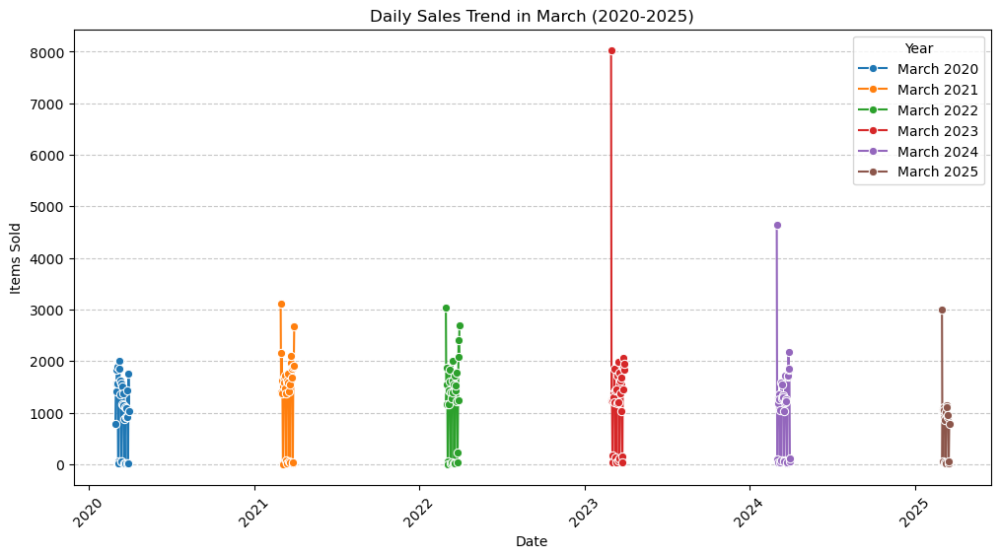

In [55]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load data (Ensure Ordered_Date is in datetime format)
df_pandas["Ordered_Date"] = pd.to_datetime(df_pandas["Ordered_Date"])

# Filter for March data only (Years: 2020 - 2025)
df_march = df_pandas[(df_pandas["Month"] == 3) & (df_pandas["Year"].between(2020, 2025))]

# Set plot size
plt.figure(figsize=(12, 6))

# Loop through each year and plot
for year in range(2020, 2026):
    df_year = df_march[df_march["Year"] == year].groupby("Ordered_Date").size().reset_index(name="Item_Count")
    sns.lineplot(data=df_year, x="Ordered_Date", y="Item_Count", marker="o", label=f"March {year}")

# Labels and title
plt.xlabel("Date")
plt.ylabel("Items Sold")
plt.title("Daily Sales Trend in March (2020-2025)")
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.xticks(rotation=45)
plt.legend(title="Year")

# Show plot
plt.show()


In [56]:
import plotly.express as px

# Define a fixed color mapping for clusters
cluster_color_map = {
    "x1": "#1f77b4",  # Blue
    "x2": "#ff7f0e",  # Orange
    "x3": "#2ca02c",  # Green
    "x4": "#d62728",  # Red
    "x5": "#9467bd"   # Purple
}

# Convert Spark DataFrame to Pandas
rfm_pandas = rfm_clusters.toPandas()

# Ensure KMeans_Segment column is a string
rfm_pandas["KMeans_Segment"] = rfm_pandas["KMeans_Segment"].astype(str)

# Compute count of transactions per date per segment
df_count = rfm_pandas.groupby(["Ordered_Date", "KMeans_Segment"]).size().reset_index(name="count")

# Plot using fixed colors
fig = px.bar(
    df_count, 
    x="Ordered_Date", 
    y="count",  # Now the correct column
    color="KMeans_Segment", 
    title="Customer Segment Trends Over Time",
    barmode="stack",
    color_discrete_map=cluster_color_map  # Apply fixed colors
)

fig.show()


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 58, Finished, Available, Finished)

In [57]:
import pandas as pd

# Ensure Ordered_Date is in datetime format
df_pandas["Ordered_Date"] = pd.to_datetime(df_pandas["Ordered_Date"])

# Extract Year & Quarter
df_pandas["Year"] = df_pandas["Ordered_Date"].dt.year
df_pandas["Quarter"] = df_pandas["Ordered_Date"].dt.to_period("Q")

# Use Quantity_Ordered as a proxy for revenue
df_pandas["Revenue"] = df_pandas["Quantity_Ordered"]  # Replace with actual revenue formula if available

# Group by Year & Quarter and sum "Revenue"
quarterly_revenue = df_pandas.groupby(["Year", "Quarter"])["Revenue"].sum().reset_index()

# Extract revenue for Q1 2025, Q4 2024, and Q1 2024
rev_q1_2025 = quarterly_revenue[(quarterly_revenue["Year"] == 2025) & (quarterly_revenue["Quarter"] == "2025Q1")]["Revenue"].values
rev_q4_2024 = quarterly_revenue[(quarterly_revenue["Year"] == 2024) & (quarterly_revenue["Quarter"] == "2024Q4")]["Revenue"].values
rev_q1_2024 = quarterly_revenue[(quarterly_revenue["Year"] == 2024) & (quarterly_revenue["Quarter"] == "2024Q1")]["Revenue"].values

# Ensure values exist before computing percentage dip
if len(rev_q1_2025) == 0 or len(rev_q4_2024) == 0 or len(rev_q1_2024) == 0:
    raise ValueError("Missing revenue data for one or more quarters!")

# Convert arrays to scalar values
rev_q1_2025, rev_q4_2024, rev_q1_2024 = rev_q1_2025[0], rev_q4_2024[0], rev_q1_2024[0]

# Compute dips
dip_q4_2024 = ((rev_q4_2024 - rev_q1_2025) / rev_q4_2024) * 100
dip_q1_2024 = ((rev_q1_2024 - rev_q1_2025) / rev_q1_2024) * 100

# Print results
print(f"📉 Revenue Dip from Q4 2024 to Q1 2025: {dip_q4_2024:.2f}%")
print(f"📉 Revenue Dip from Q1 2024 to Q1 2025: {dip_q1_2024:.2f}%")


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 59, Finished, Available, Finished)

📉 Revenue Dip from Q4 2024 to Q1 2025: 69.32%
📉 Revenue Dip from Q1 2024 to Q1 2025: 29.14%


In [58]:
import pandas as pd

# Ensure Ordered_Date is in datetime format
df_pandas["Ordered_Date"] = pd.to_datetime(df_pandas["Ordered_Date"])

# Extract Year & Quarter
df_pandas["Year"] = df_pandas["Ordered_Date"].dt.year
df_pandas["Quarter"] = df_pandas["Ordered_Date"].dt.to_period("Q")

# Filter for Q1 (Jan, Feb, Mar) from 2020 to 2025
df_q1 = df_pandas[(df_pandas["Year"].between(2020, 2025)) & (df_pandas["Quarter"].dt.quarter == 1)]

# Group by Year & Quarter and sum "Quantity_Ordered" (as proxy for Revenue)
q1_revenue = df_q1.groupby(["Year", "Quarter"])["Quantity_Ordered"].sum().reset_index()

# Rename for clarity
q1_revenue.rename(columns={"Quantity_Ordered": "Total_Sales_Q1"}, inplace=True)

# Display the Q1 data for each year
print(q1_revenue)


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 60, Finished, Available, Finished)

   Year Quarter Total_Sales_Q1
0  2020  2020Q1  446673.800000
1  2021  2021Q1  413125.550000
2  2022  2022Q1  534265.090000
3  2023  2023Q1  565258.280000
4  2024  2024Q1  415269.260000
5  2025  2025Q1  294253.500000


In [59]:
import pandas as pd

# Ensure Ordered_Date is in datetime format
df_pandas["Ordered_Date"] = pd.to_datetime(df_pandas["Ordered_Date"])

# Extract Year & Quarter
df_pandas["Year"] = df_pandas["Ordered_Date"].dt.year
df_pandas["Quarter"] = df_pandas["Ordered_Date"].dt.quarter

# Filter for Q1 (Jan-Mar) and years 2020-2025
q1_revenue = df_pandas[df_pandas["Quarter"] == 1]

# Aggregate total sales for Q1 per year
q1_sales = q1_revenue.groupby("Year")["Quantity_Ordered"].sum().reset_index()
q1_sales.rename(columns={"Quantity_Ordered": "Total_Sales_Q1"}, inplace=True)

# Calculate percentage dip compared to previous year's Q1
q1_sales["Dip_%"] = q1_sales["Total_Sales_Q1"].pct_change() * 100

# Display results from 2021 onward (since 2020 has no previous Q1 to compare)
print(q1_sales)


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 61, Finished, Available, Finished)

    Year Total_Sales_Q1                           Dip_%
0   2010      -1.000000                             NaN
1   2011      -1.000000                               0
2   2012     -15.000000                            1400
3   2013    -191.000000   1173.333333333333333333333333
4   2014    -103.000000  -46.07329842931937172774869110
5   2015    1818.000000  -1865.048543689320388349514563
6   2016    8496.000000   367.3267326732673267326732673
7   2017    5751.000000  -32.30932203389830508474576271
8   2018    9265.000000   61.10241697096157190053903670
9   2019    1458.000000  -84.26335671883432271991365353
10  2020  446673.800000   30536.06310013717421124828532
11  2021  413125.550000  -7.510682292088768134598447460
12  2022  534265.090000   29.32269379126999044237278470
13  2023  565258.280000   5.801088369820307742734978200
14  2024  415269.260000  -26.53459936933608473634388867
15  2025  294253.500000  -29.14151651870403313743954946


In [60]:
import pandas as pd

# Ensure Ordered_Date is in datetime format
df_pandas["Ordered_Date"] = pd.to_datetime(df_pandas["Ordered_Date"])

# Extract Year & Quarter
df_pandas["Year"] = df_pandas["Ordered_Date"].dt.year
df_pandas["Quarter"] = df_pandas["Ordered_Date"].dt.quarter

# Filter for Q1 (Jan-Mar) and years 2020-2025
q1_revenue = df_pandas[(df_pandas["Quarter"] == 1) & (df_pandas["Year"].between(2020, 2025))]

# Aggregate total sales for Q1 per year
q1_sales = q1_revenue.groupby("Year")["Quantity_Ordered"].sum().reset_index()
q1_sales.rename(columns={"Quantity_Ordered": "Total_Sales_Q1"}, inplace=True)

# Calculate percentage dip compared to previous year's Q1
q1_sales["Dip_%"] = q1_sales["Total_Sales_Q1"].pct_change() * 100

# Display results
print(q1_sales)


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 62, Finished, Available, Finished)

   Year Total_Sales_Q1                           Dip_%
0  2020  446673.800000                             NaN
1  2021  413125.550000  -7.510682292088768134598447460
2  2022  534265.090000   29.32269379126999044237278470
3  2023  565258.280000   5.801088369820307742734978200
4  2024  415269.260000  -26.53459936933608473634388867
5  2025  294253.500000  -29.14151651870403313743954946


In [61]:
import pandas as pd

# Ensure Ordered_Date is in datetime format
df_pandas["Ordered_Date"] = pd.to_datetime(df_pandas["Ordered_Date"])

# Extract Year & Quarter
df_pandas["Year"] = df_pandas["Ordered_Date"].dt.year
df_pandas["Quarter"] = df_pandas["Ordered_Date"].dt.quarter

# Filter for Q1 (Jan-Mar) and years 2020-2025
q1_data = df_pandas[(df_pandas["Quarter"] == 1) & (df_pandas["Year"].between(2020, 2025))]

# Aggregate total sales per product per year
product_sales_q1 = q1_data.groupby(["Year", "Item_Number"])["Quantity_Ordered"].sum().reset_index()
product_sales_q1.rename(columns={"Quantity_Ordered": "Total_Sales_Q1"}, inplace=True)

# Pivot data to compare sales of each product across years
product_sales_pivot = product_sales_q1.pivot(index="Item_Number", columns="Year", values="Total_Sales_Q1").fillna(0)

# Calculate percentage change from 2024 to 2025
product_sales_pivot["Dip_%"] = ((product_sales_pivot[2025] - product_sales_pivot[2024]) / product_sales_pivot[2024]) * 100

# Sort by highest drop in sales
product_sales_pivot_sorted = product_sales_pivot.sort_values(by="Dip_%")

# Display products with the highest dip in Q1 2025
print(product_sales_pivot_sorted)


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 63, Finished, Available, Finished)

DivisionByZero: [<class 'decimal.DivisionByZero'>]

In [62]:
import pandas as pd

# Ensure Ordered_Date is in datetime format
df_pandas["Ordered_Date"] = pd.to_datetime(df_pandas["Ordered_Date"])

# Extract Year & Quarter
df_pandas["Year"] = df_pandas["Ordered_Date"].dt.year
df_pandas["Quarter"] = df_pandas["Ordered_Date"].dt.quarter

# Filter for Q1 (Jan-Mar) and years 2020-2025
q1_data = df_pandas[(df_pandas["Quarter"] == 1) & (df_pandas["Year"].between(2020, 2025))]

# Aggregate total sales per product per year
product_sales_q1 = q1_data.groupby(["Year", "Item_Number"])["Quantity_Ordered"].sum().reset_index()
product_sales_q1.rename(columns={"Quantity_Ordered": "Total_Sales_Q1"}, inplace=True)

# Pivot data to compare sales of each product across years
product_sales_pivot = product_sales_q1.pivot(index="Item_Number", columns="Year", values="Total_Sales_Q1").fillna(0)

# Avoid division by zero by replacing 0 sales in Q1 2024 with NaN
product_sales_pivot["Dip_%"] = ((product_sales_pivot[2025] - product_sales_pivot[2024]) / product_sales_pivot[2024].replace(0, float("nan"))) * 100

# Sort by highest drop in sales
product_sales_pivot_sorted = product_sales_pivot.sort_values(by="Dip_%")

# Display products with the highest dip in Q1 2025
print(product_sales_pivot_sorted)


StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 64, Finished, Available, Finished)

Year                       2020       2021        2022       2023        2024  \
Item_Number                                                                     
AA-A-KIT10            40.000000  70.000000  151.000000  59.000000  -10.000000   
C6172A                 0.000000   0.000000   -2.000000   0.000000   -1.000000   
1600-00-011           -4.000000   2.000000   16.000000  39.000000   -1.000000   
KS8511                 1.000000   1.000000    3.000000  -2.000000   -1.000000   
7010-03               18.000000   6.000000    0.000000   6.000000   -1.000000   
...                         ...        ...         ...        ...         ...   
YKNOTFLEX_SET          0.000000   0.000000    0.000000          0           0   
ZONESPECIFIC2          1.000000          0           0          0           0   
ZONESPECIFIC2_OPT_OC   1.000000          0           0          0           0   
ZONESPECIFIC2_SET      0.000000   0.000000    0.000000   1.000000    0.000000   
ZONESPECIFIC2_STD_OC   1.000

In [63]:
display(product_sales_pivot_sorted)

StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 65, Finished, Available, Finished)

SynapseWidget(Synapse.DataFrame, 2018c319-00a4-4e0b-b442-b097cb8b1f13)

StatementMeta(, dcfacda4-76a7-485b-ae7e-fd093efb5bd7, 66, Finished, Available, Finished)

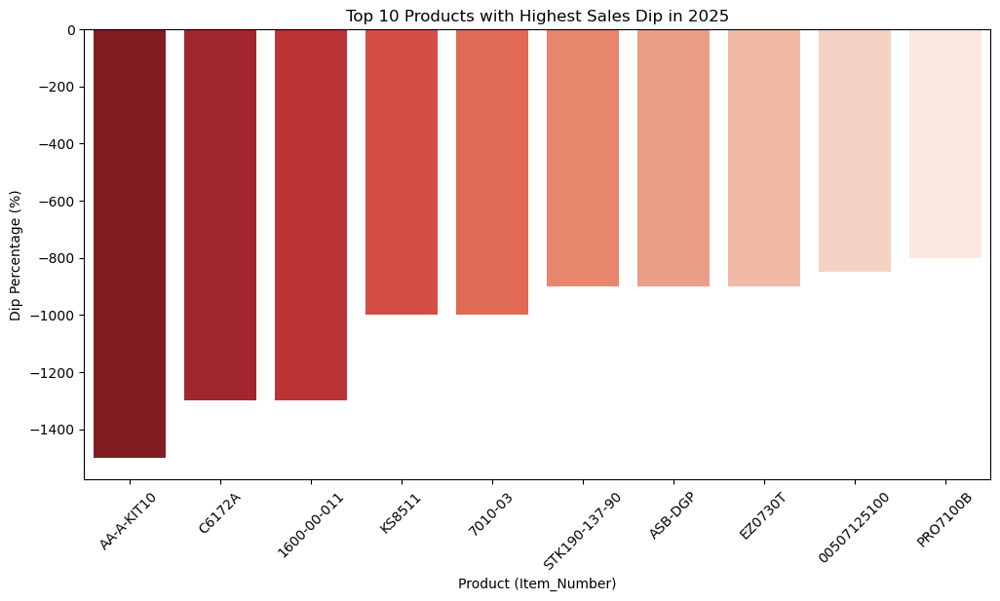

In [64]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Pivot data to get sales per year for each product
product_sales_pivot = product_sales_q1.pivot(index="Item_Number", columns="Year", values="Total_Sales_Q1").fillna(0)

# Avoid division by zero: Replace zero sales in 2024 with NaN
product_sales_pivot["Dip_%"] = ((product_sales_pivot[2025] - product_sales_pivot[2024]) / 
                                product_sales_pivot[2024].replace(0, float("nan"))) * 100

# Fill NaN values with -100% (indicating complete drop in sales)
product_sales_pivot["Dip_%"] = product_sales_pivot["Dip_%"].fillna(-100)

# Convert "Dip_%" to numeric
product_sales_pivot["Dip_%"] = pd.to_numeric(product_sales_pivot["Dip_%"], errors="coerce")

# Sort by highest drop in sales
product_sales_pivot_sorted = product_sales_pivot.sort_values(by="Dip_%")

# Select top 10 products with the biggest dip
top_dip_products = product_sales_pivot_sorted.nsmallest(10, "Dip_%")

# Plot bar chart
plt.figure(figsize=(12, 6))
sns.barplot(x=top_dip_products.index, y=top_dip_products["Dip_%"], palette="Reds_r")
plt.xticks(rotation=45)
plt.xlabel("Product (Item_Number)")
plt.ylabel("Dip Percentage (%)")
plt.title("Top 10 Products with Highest Sales Dip in 2025")
plt.show()
